<a href="https://colab.research.google.com/github/vBazilevich/Fall2022-CV-FinalProjectDemo/blob/master/Introduction_to_CV_On_Sea_object_detection_Live_demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# On sea object detection. Live demo
This notebook is based on original [tutorial](https://colab.research.google.com/github/ultralytics/yolov5/blob/master/tutorial.ipynb).

## Setup
Cloning repository, installing requirements, importing required libraries, and downloading sample images.

In [ ]:
# Download YOLOv5 repository and install dependencies
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
%pip install -qr requirements.txt  # install

# Download best model weights
%pip install gdown
!gdown --no-cookies 'https://drive.google.com/uc?id=1XF8YgBCvpaP_fpaVZ8i5b-OnRGycVXIe&confirm=pbef' -O weights.zip
!unzip weights.zip

# Download sample images out of the original data set
!mkdir images
!wget -O images/1.jpg https://i.dailymail.co.uk/i/pix/2013/09/21/article-2427876-1BE52D8F000005DC-819_964x640.jpg
!wget -O images/2.jpg https://i.dailymail.co.uk/i/pix/2013/09/21/article-2427876-1BE4DE8D000005DC-170_964x640.jpg

# Download test subset of SeaDronesSee dataset
!gdown https://drive.google.com/drive/folders/1opbh8TtYyH_JnjXK37DfVKU-9ASKRgvq -O ./sns_data --folder

Cloning into 'yolov5'...
remote: Enumerating objects: 14149, done.
remote: Counting objects: 100% (19/19), done.
remote: Compressing objects: 100% (11/11), done.
remote: Total 14149 (delta 8), reused 14 (delta 8), pack-reused 14130
Receiving objects: 100% (14149/14149), 13.54 MiB | 20.79 MiB/s, done.
Resolving deltas: 100% (9718/9718), done.
/content/yolov5
     |████████████████████████████████| 182 kB 5.2 MB/s 
     |████████████████████████████████| 62 kB 667 kB/s 
     |████████████████████████████████| 1.6 MB 48.0 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Downloading...
From: https://drive.google.com/uc?id=1XF8YgBCvpaP_fpaVZ8i5b-OnRGycVXIe&confirm=pbef
To: /content/yolov5/weights.zip
100% 54.8M/54.8M [00:01<00:00, 53.4MB/s]
Archive:  weights.zip
  inflating: best_medium.pt          
  inflating: best_nano.pt            
  inflating: best_small.pt           
--2022-11-24 09:18:00--  https://i.dailymail.co.uk/i/pix/2013/

In [ ]:
# Import required libraries
import torch
import matplotlib.pyplot as plt
import os
from PIL import Image
import utils

In [ ]:
# Configure the notebook
plt.rcParams["figure.figsize"] = (12,12)
display = utils.notebook_init()

YOLOv5 🚀 v7.0-4-g7398d2d Python-3.7.15 torch-1.12.1+cu113 CPU


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 22.7/107.7 GB disk)


## Detection
Upload your image file to a Colab and input the path

In [ ]:
# Run detection on sample images
!python detect.py --weights best_medium.pt --conf 0.25 --source images/

detect: weights=['best_medium.pt'], source=images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.7.15 torch-1.12.1+cu113 CPU

Fusing layers... 
YOLOv5m summary: 212 layers, 20877180 parameters, 0 gradients, 47.9 GFLOPs
image 1/2 /content/yolov5/images/1.jpg: 448x640 1 swimmer, 4 floaters, 5 boats, 824.5ms
image 2/2 /content/yolov5/images/2.jpg: 448x640 17 floaters, 1 boat, 804.7ms
Speed: 2.6ms pre-process, 814.6ms inference, 11.3ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp


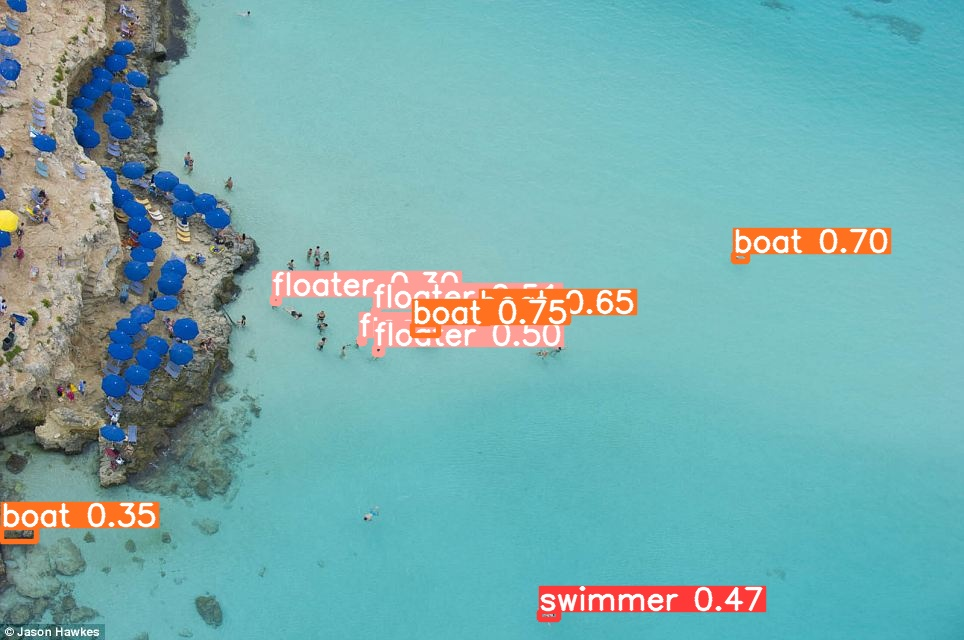

In [ ]:
display.Image(filename='runs/detect/exp/1.jpg')

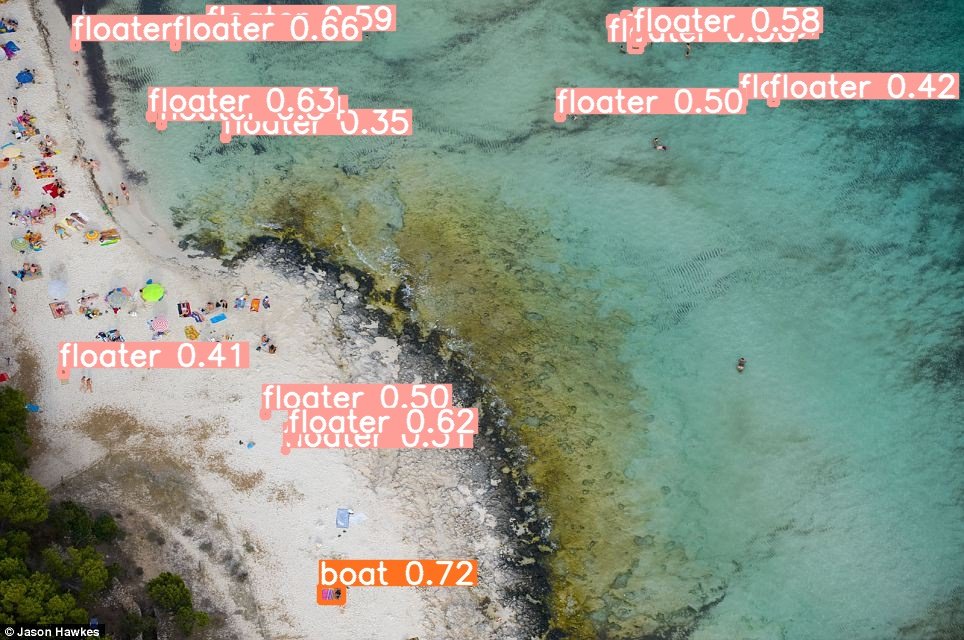

In [ ]:
display.Image(filename='runs/detect/exp/2.jpg')

## Comparing Nano, Small and Medium
### Images from test subset

In [ ]:
# Run detection on sample images
!python detect.py --weights best_nano.pt --conf 0.25 --source sns_data/
!python detect.py --weights best_small.pt --conf 0.25 --source sns_data/
!python detect.py --weights best_medium.pt --conf 0.25 --source sns_data/

detect: weights=['best_nano.pt'], source=sns_data/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.7.15 torch-1.12.1+cu113 CPU

Fusing layers... 
YOLOv5n summary: 157 layers, 1768636 parameters, 0 gradients, 4.2 GFLOPs
image 1/3 /content/yolov5/sns_data/3840-2160-max.png: 384x640 1 swimmer, 2 floaters, 3 boats, 4 swimmer on boats, 1 floater on boat, 101.6ms
image 2/3 /content/yolov5/sns_data/5589.png: 384x640 2 swimmers, 4 floaters, 3 boats, 2 swimmer on boats, 121.9ms
image 3/3 /content/yolov5/sns_data/606.png: 448x640 1 floater, 4 boats, 119.2ms
Speed: 2.4ms pre-process, 114.2ms inference, 1.0ms NMS per image

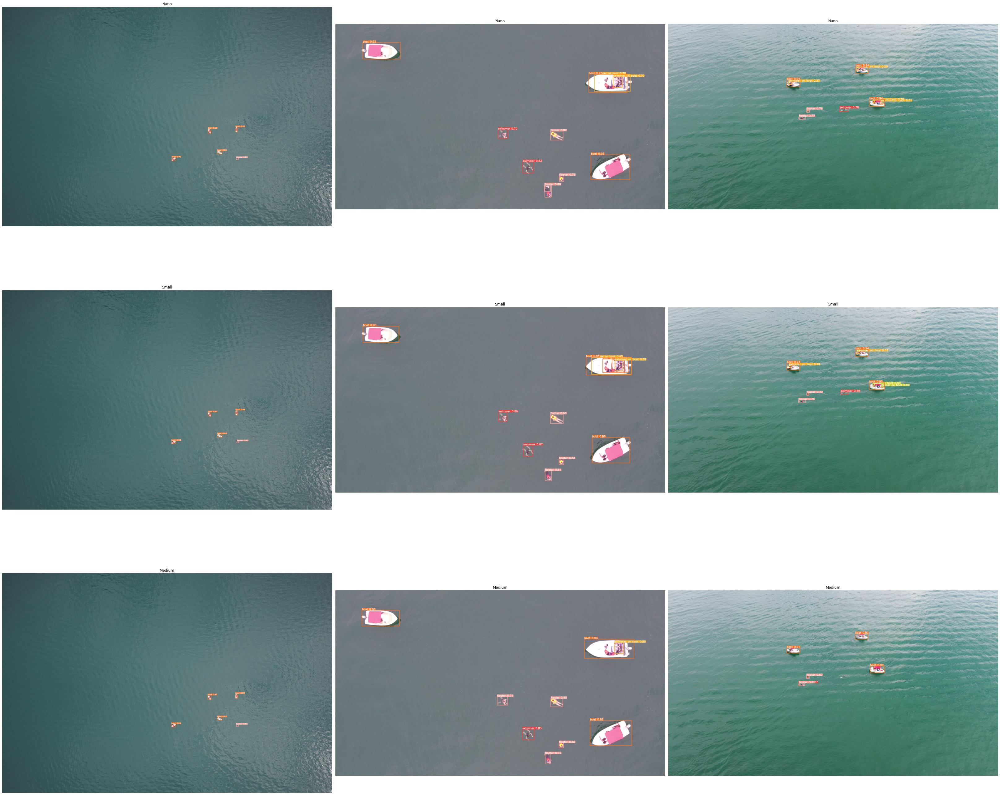

In [ ]:
figure = plt.figure(figsize=(45,45), tight_layout=True)
folders = ['runs/detect/exp2/', 'runs/detect/exp3/', 'runs/detect/exp4/']
models = ['Nano', 'Small', 'Medium']
for i, (folder, model) in enumerate(zip(folders, models)):
    images = [folder + img for img in os.listdir(folder)]
    for j, img in enumerate(images):
        img = Image.open(img)
        idx = i * len(images) + j + 1
        figure.add_subplot(3, 3, idx)
        plt.title(model)
        plt.axis('off')
        plt.imshow(img)

### Images from the Internet

In [ ]:
# Run detection on sample images
!python detect.py --weights best_nano.pt --conf 0.25 --source images/
!python detect.py --weights best_small.pt --conf 0.25 --source images/
!python detect.py --weights best_medium.pt --conf 0.25 --source images/

detect: weights=['best_nano.pt'], source=images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-4-g7398d2d Python-3.7.15 torch-1.12.1+cu113 CPU

Fusing layers... 
YOLOv5n summary: 157 layers, 1768636 parameters, 0 gradients, 4.2 GFLOPs
image 1/2 /content/yolov5/images/1.jpg: 448x640 1 swimmer, 8 floaters, 2 boats, 126.6ms
image 2/2 /content/yolov5/images/2.jpg: 448x640 3 swimmers, 14 floaters, 111.6ms
Speed: 2.5ms pre-process, 119.1ms inference, 1.2ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp5
detect: weights=['best_small.pt'], source=images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.2

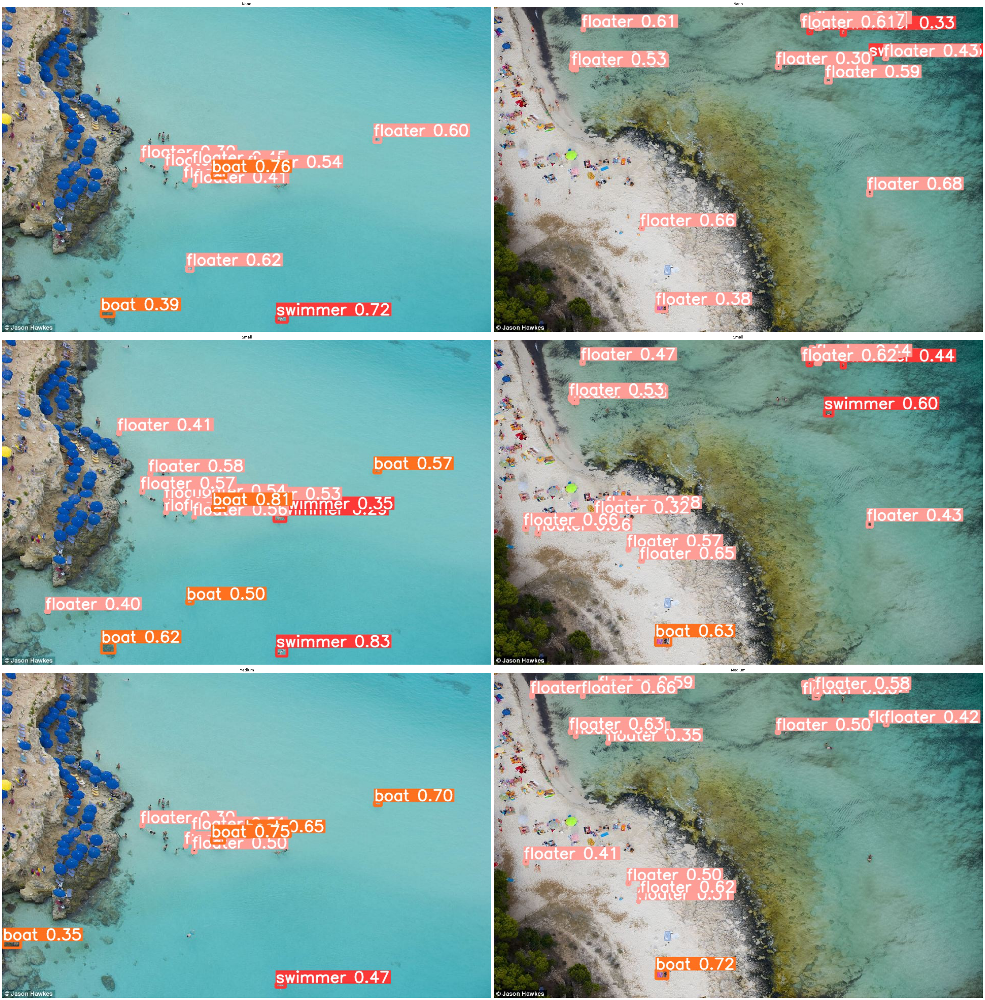

In [ ]:
figure = plt.figure(figsize=(45,45), tight_layout=True)
folders = ['runs/detect/exp5/', 'runs/detect/exp6/', 'runs/detect/exp7/']
models = ['Nano', 'Small', 'Medium']
for i, (folder, model) in enumerate(zip(folders, models)):
    images = [folder + img for img in os.listdir(folder)]
    for j, img in enumerate(images):
        img = Image.open(img)
        idx = i * len(images) + j + 1
        figure.add_subplot(3, 2, idx)
        plt.title(model)
        plt.axis('off')
        plt.imshow(img)